<a href="https://colab.research.google.com/github/mc-off/ML/blob/main/ml_improvement/ML_improvement.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Data and utils imports

In [11]:
pip install torch

In [12]:
pip install tensorboard

In [13]:
pip install torchvision

In [65]:
from torchvision import datasets, transforms
from torch.utils.data import DataLoader

from torch import nn
import torch.nn.functional as F
import torch

from torch.utils.tensorboard import SummaryWriter

import os, shutil

In [63]:
logs_base_dir = "runs"
os.makedirs(logs_base_dir, exist_ok=True)

In [66]:
# for filename in os.listdir(logs_base_dir):
#     file_path = os.path.join(logs_base_dir, filename)
#     try:
#         if os.path.isfile(file_path) or os.path.islink(file_path):
#             os.unlink(file_path)
#         elif os.path.isdir(file_path):
#             shutil.rmtree(file_path)
#     except Exception as e:
#         print('Failed to delete %s. Reason: %s' % (file_path, e))

In [55]:
%load_ext tensorboard

In [15]:
def get_data():
    train_data = datasets.FashionMNIST('./data/', transform=transforms.ToTensor(),
                                       train=True, download=True)
    val_data = datasets.FashionMNIST('./data/', transform=transforms.ToTensor(),
                                     train=False, download=True)

    print(f'Train size: {len(train_data)}, Test size: {len(val_data)}')

    train_loader = DataLoader(train_data, batch_size=32, num_workers=8, shuffle=True)
    val_loader = DataLoader(val_data, batch_size=16, num_workers=2)
    return train_loader, val_loader

In [24]:
args = {"num_classes": 10, 
        "lr": 0.01,
        "epochs_num": 10,
        "print_every": 100}

#Stock

In [16]:
class MLP(nn.Module):
    def __init__(self, num_classes):
        super(MLP, self).__init__() 
        self.num_classes = num_classes
        self.fc1 = nn.Linear(784, 100)
        self.fc2 = nn.Linear(100, 50)
        self.fc3 = nn.Linear(50, self.num_classes)

    def forward(self, x):
        x = x.view(x.size(0), -1)
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = self.fc3(x)

        return x

In [17]:
def evaluate(model, test_loader, criterion):
    model.eval()

    with torch.no_grad():
        avg_loss = 0.0
        avg_acc = 0.0
        for x, y in test_loader:      
            out = model(x)
            out_s = F.softmax(out, dim=1)
            _, preds = torch.max(out_s, dim=1)
            loss = criterion(out, y)
            avg_loss += loss.item()
            avg_acc += (preds == y).numpy().mean()

        avg_loss /= len(test_loader)
        avg_acc /= len(test_loader)

    model.train()
    return avg_loss, avg_acc

In [61]:
def train_stock(args):
    t_loader, v_loader = get_data()
    writer = SummaryWriter()
    net = MLP(args['num_classes'])
    writer.add_graph(net, torch.zeros((1, 1, 28, 28)))
    optimizer = torch.optim.SGD(net.parameters(), lr=args['lr'])
    lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=3, gamma=0.1) 
    criterion = nn.CrossEntropyLoss()
    for e in range(args['epochs_num']):
        for i, (x, y) in enumerate(t_loader):
            optimizer.zero_grad()
            out = net(x)
            loss = criterion(out, y)
            loss.backward()  # Backpropagation
            optimizer.step()  # Step of Stochastic Gradient Descent
            writer.add_scalar('Train/Loss', loss.item(), e*len(t_loader) + i)
            if i % args['print_every'] == 0:
                print(f'Epoch: {e}, Iteration: {i}, Train loss: {loss}')
                v_loss, v_acc = evaluate(net, v_loader, criterion)
                print(f'Epoch: {e}, Iteration: {i}, Val loss: {v_loss}, Val acc: {v_acc}')
                writer.add_scalar('Val/Loss', v_loss, e*len(t_loader) + i)
                writer.add_scalar('Val/Acc', v_acc, e*len(t_loader) + i)
        lr_scheduler.step()

А вот здесь прикол, конечно. В демо на паре точность была под 75 процентов, тут же нужно перебить уже под 83. Почему так себя не показал алгос на занятии - не понятно. Но будем пробовать

In [68]:
train_stock(args)

Train size: 60000, Test size: 10000
Epoch: 0, Iteration: 0, Train loss: 2.2969679832458496
Epoch: 0, Iteration: 0, Val loss: 2.309013819885254, Val acc: 0.1373
Epoch: 0, Iteration: 100, Train loss: 2.1811773777008057
Epoch: 0, Iteration: 100, Val loss: 2.1788947650909423, Val acc: 0.2075
Epoch: 0, Iteration: 200, Train loss: 2.002950668334961
Epoch: 0, Iteration: 200, Val loss: 1.982578728866577, Val acc: 0.2816
Epoch: 0, Iteration: 300, Train loss: 1.7006721496582031
Epoch: 0, Iteration: 300, Val loss: 1.7181295715332032, Val acc: 0.4935
Epoch: 0, Iteration: 400, Train loss: 1.5124446153640747
Epoch: 0, Iteration: 400, Val loss: 1.452449214553833, Val acc: 0.5808
Epoch: 0, Iteration: 500, Train loss: 1.2151145935058594
Epoch: 0, Iteration: 500, Val loss: 1.24398651638031, Val acc: 0.6156
Epoch: 0, Iteration: 600, Train loss: 1.0961724519729614
Epoch: 0, Iteration: 600, Val loss: 1.10573484954834, Val acc: 0.626
Epoch: 0, Iteration: 700, Train loss: 0.886436402797699
Epoch: 0, Iteratio

#Lots of layers

Идея попробовать большее кол-во слоев, нежели чем было 2 и 3

In [44]:
class MLP_improve_1(nn.Module):
    def __init__(self, num_classes):
        super(MLP_improve_1, self).__init__() 
        self.num_classes = num_classes
        self.fc1 = nn.Linear(784, 300)
        self.fc2 = nn.Linear(300, 100)
        self.fc3 = nn.Linear(100, 30)
        self.fc4 = nn.Linear(30, 20)
        self.fc5 = nn.Linear(20, self.num_classes)

    def forward(self, x):
        x = x.view(x.size(0), -1)
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = F.relu(self.fc3(x))
        x = F.relu(self.fc4(x))
        x = self.fc5(x)

        return x

In [84]:
def train(MLP_local, args, step_size_value=3, gamma_value=0.1):
    t_loader, v_loader = get_data()
    writer = SummaryWriter()
    net = MLP_local(args['num_classes'])
    writer.add_graph(net, torch.zeros((1, 1, 28, 28)))
    optimizer = torch.optim.SGD(net.parameters(), lr=args['lr'])
    lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size_value, gamma=gamma_value) 
    criterion = nn.CrossEntropyLoss()
    for e in range(args['epochs_num']):
        for i, (x, y) in enumerate(t_loader):
            optimizer.zero_grad()
            out = net(x)
            loss = criterion(out, y)
            loss.backward()  # Backpropagation
            optimizer.step()  # Step of Stochastic Gradient Descent
            writer.add_scalar('Train/Loss', loss.item(), e*len(t_loader) + i)
            if i % args['print_every'] == 0:
                print(f'Epoch: {e}, Iteration: {i}, Train loss: {loss}')
                v_loss, v_acc = evaluate(net, v_loader, criterion)
                print(f'Epoch: {e}, Iteration: {i}, Val loss: {v_loss}, Val acc: {v_acc}')
                writer.add_scalar('Val/Loss', v_loss, e*len(t_loader) + i)
                writer.add_scalar('Val/Acc', v_acc, e*len(t_loader) + i)
        lr_scheduler.step()

Не смог(

In [69]:
train(MLP_improve_1, args)

Train size: 60000, Test size: 10000
Epoch: 0, Iteration: 0, Train loss: 2.3534531593322754
Epoch: 0, Iteration: 0, Val loss: 2.3113225902557373, Val acc: 0.1
Epoch: 0, Iteration: 100, Train loss: 2.320093870162964
Epoch: 0, Iteration: 100, Val loss: 2.306817932128906, Val acc: 0.1
Epoch: 0, Iteration: 200, Train loss: 2.283719778060913
Epoch: 0, Iteration: 200, Val loss: 2.3029898509979247, Val acc: 0.1
Epoch: 0, Iteration: 300, Train loss: 2.2938597202301025
Epoch: 0, Iteration: 300, Val loss: 2.2988664558410643, Val acc: 0.1
Epoch: 0, Iteration: 400, Train loss: 2.292558193206787
Epoch: 0, Iteration: 400, Val loss: 2.293961897659302, Val acc: 0.1314
Epoch: 0, Iteration: 500, Train loss: 2.3000075817108154
Epoch: 0, Iteration: 500, Val loss: 2.2866069904327393, Val acc: 0.1655
Epoch: 0, Iteration: 600, Train loss: 2.2780559062957764
Epoch: 0, Iteration: 600, Val loss: 2.2760814422607423, Val acc: 0.1735
Epoch: 0, Iteration: 700, Train loss: 2.2418603897094727
Epoch: 0, Iteration: 700,

In [ ]:
%tensorboard --logdir {logs_base_dir}

#Back to 2 layers

##Classic

In [75]:
class MLP_improve_2(nn.Module):
    def __init__(self, num_classes):
        super(MLP_improve_2, self).__init__() 
        self.num_classes = num_classes
        self.fc1 = nn.Linear(784, 100)
        self.fc2 = nn.Linear(100, self.num_classes)

    def forward(self, x):
        x = x.view(x.size(0), -1)
        x = F.relu(self.fc1(x))
        x = self.fc2(x)

        return x

Еее, перевалили за 83, 2 слоя пока рулят

In [76]:
train(MLP_improve_2, args)

Train size: 60000, Test size: 10000
Epoch: 0, Iteration: 0, Train loss: 2.322036027908325
Epoch: 0, Iteration: 0, Val loss: 2.3038585838317873, Val acc: 0.0858
Epoch: 0, Iteration: 100, Train loss: 1.8685517311096191
Epoch: 0, Iteration: 100, Val loss: 1.8787957624435425, Val acc: 0.5979
Epoch: 0, Iteration: 200, Train loss: 1.4430179595947266
Epoch: 0, Iteration: 200, Val loss: 1.4482476558685302, Val acc: 0.6244
Epoch: 0, Iteration: 300, Train loss: 1.22368586063385
Epoch: 0, Iteration: 300, Val loss: 1.1926610632896424, Val acc: 0.6456
Epoch: 0, Iteration: 400, Train loss: 1.0952579975128174
Epoch: 0, Iteration: 400, Val loss: 1.0410820127487184, Val acc: 0.6667
Epoch: 0, Iteration: 500, Train loss: 1.0503085851669312
Epoch: 0, Iteration: 500, Val loss: 0.9521267161846161, Val acc: 0.6743
Epoch: 0, Iteration: 600, Train loss: 0.8555783629417419
Epoch: 0, Iteration: 600, Val loss: 0.894873946428299, Val acc: 0.683
Epoch: 0, Iteration: 700, Train loss: 0.9264307618141174
Epoch: 0, Ite

##Попробуем поиграться с параметром lr

###lr=0.001

In [78]:
args_copy = args
args_copy['lr'] = 0.001

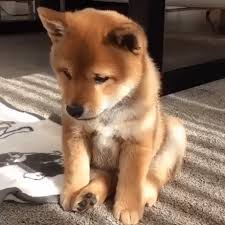

In [79]:
train(MLP_improve_2, args_copy)

Train size: 60000, Test size: 10000
Epoch: 0, Iteration: 0, Train loss: 2.3054866790771484
Epoch: 0, Iteration: 0, Val loss: 2.2962661987304687, Val acc: 0.0836
Epoch: 0, Iteration: 100, Train loss: 2.218155860900879
Epoch: 0, Iteration: 100, Val loss: 2.249115114593506, Val acc: 0.1853
Epoch: 0, Iteration: 200, Train loss: 2.1634132862091064
Epoch: 0, Iteration: 200, Val loss: 2.204380696487427, Val acc: 0.2729
Epoch: 0, Iteration: 300, Train loss: 2.164987802505493
Epoch: 0, Iteration: 300, Val loss: 2.1633526638031007, Val acc: 0.3305
Epoch: 0, Iteration: 400, Train loss: 2.1239571571350098
Epoch: 0, Iteration: 400, Val loss: 2.1219281354904176, Val acc: 0.3942
Epoch: 0, Iteration: 500, Train loss: 2.048307180404663
Epoch: 0, Iteration: 500, Val loss: 2.0783383714675905, Val acc: 0.4774
Epoch: 0, Iteration: 600, Train loss: 2.0334255695343018
Epoch: 0, Iteration: 600, Val loss: 2.032401463699341, Val acc: 0.5188
Epoch: 0, Iteration: 700, Train loss: 1.9607573747634888
Epoch: 0, Iter

###lr=0.1

In [81]:
args_copy = args
args_copy['lr'] = 0.1

87 преодолено 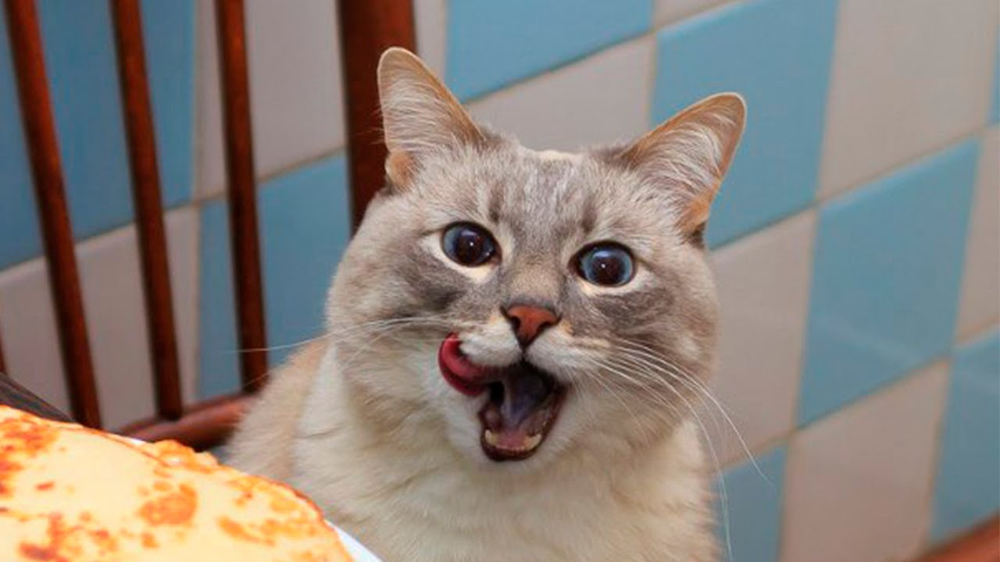

In [82]:
train(MLP_improve_2, args_copy)

Train size: 60000, Test size: 10000
Epoch: 0, Iteration: 0, Train loss: 2.3338770866394043
Epoch: 0, Iteration: 0, Val loss: 2.2916586292266845, Val acc: 0.1065
Epoch: 0, Iteration: 100, Train loss: 0.6609774827957153
Epoch: 0, Iteration: 100, Val loss: 0.8577933084487915, Val acc: 0.657
Epoch: 0, Iteration: 200, Train loss: 0.8549941182136536
Epoch: 0, Iteration: 200, Val loss: 0.7142731206417083, Val acc: 0.7452
Epoch: 0, Iteration: 300, Train loss: 0.9438491463661194
Epoch: 0, Iteration: 300, Val loss: 0.6546300739526749, Val acc: 0.7673
Epoch: 0, Iteration: 400, Train loss: 0.5175378322601318
Epoch: 0, Iteration: 400, Val loss: 0.6109737406253815, Val acc: 0.7736
Epoch: 0, Iteration: 500, Train loss: 0.6295679211616516
Epoch: 0, Iteration: 500, Val loss: 0.5529064084529877, Val acc: 0.8097
Epoch: 0, Iteration: 600, Train loss: 0.29222139716148376
Epoch: 0, Iteration: 600, Val loss: 0.6619298593521118, Val acc: 0.77
Epoch: 0, Iteration: 700, Train loss: 0.5032830238342285
Epoch: 0, 

##Gamma

Оставляем lr=0.1 и дальше пробуем тюнить

###Gamma = 0.01

In [85]:
train(MLP_improve_2, args_copy, gamma_value=0.01)

Train size: 60000, Test size: 10000
Epoch: 0, Iteration: 0, Train loss: 2.2980141639709473
Epoch: 0, Iteration: 0, Val loss: 2.2558373790740966, Val acc: 0.2763
Epoch: 0, Iteration: 100, Train loss: 0.7974514961242676
Epoch: 0, Iteration: 100, Val loss: 0.8293916484832764, Val acc: 0.6655
Epoch: 0, Iteration: 200, Train loss: 0.5583194494247437
Epoch: 0, Iteration: 200, Val loss: 0.716762305021286, Val acc: 0.7451
Epoch: 0, Iteration: 300, Train loss: 0.8068423867225647
Epoch: 0, Iteration: 300, Val loss: 0.669805080652237, Val acc: 0.7684
Epoch: 0, Iteration: 400, Train loss: 0.39502108097076416
Epoch: 0, Iteration: 400, Val loss: 0.591462064409256, Val acc: 0.7888
Epoch: 0, Iteration: 500, Train loss: 0.5383173823356628
Epoch: 0, Iteration: 500, Val loss: 0.6018622105836868, Val acc: 0.7693
Epoch: 0, Iteration: 600, Train loss: 0.3427577316761017
Epoch: 0, Iteration: 600, Val loss: 0.561895632815361, Val acc: 0.7989
Epoch: 0, Iteration: 700, Train loss: 0.21609556674957275
Epoch: 0, 

###Gamma=0.5

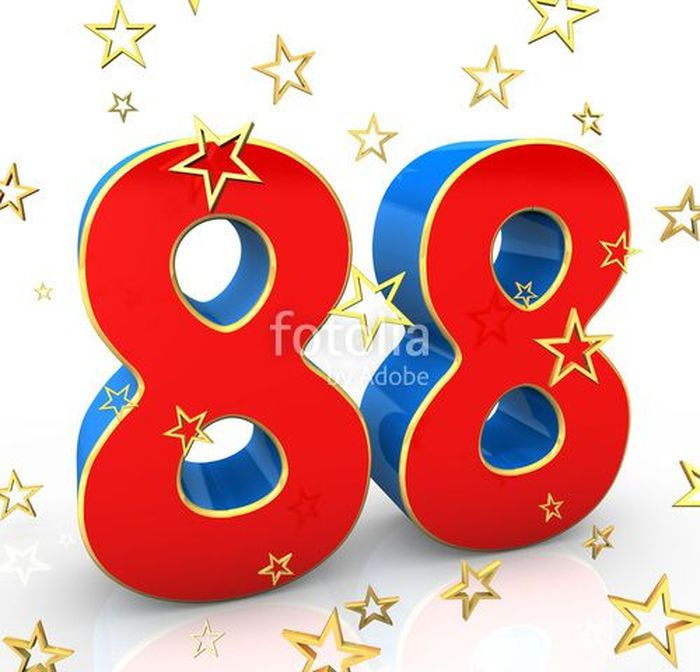

In [86]:
train(MLP_improve_2, args_copy, gamma_value=0.5)

Train size: 60000, Test size: 10000
Epoch: 0, Iteration: 0, Train loss: 2.348179340362549
Epoch: 0, Iteration: 0, Val loss: 2.289378232192993, Val acc: 0.1156
Epoch: 0, Iteration: 100, Train loss: 0.7614837884902954
Epoch: 0, Iteration: 100, Val loss: 0.846392622089386, Val acc: 0.6714
Epoch: 0, Iteration: 200, Train loss: 0.5726014375686646
Epoch: 0, Iteration: 200, Val loss: 0.6741770662307739, Val acc: 0.7531
Epoch: 0, Iteration: 300, Train loss: 0.7796882390975952
Epoch: 0, Iteration: 300, Val loss: 0.6550903506994248, Val acc: 0.7691
Epoch: 0, Iteration: 400, Train loss: 0.4419746994972229
Epoch: 0, Iteration: 400, Val loss: 0.6660885659217834, Val acc: 0.7429
Epoch: 0, Iteration: 500, Train loss: 0.47425442934036255
Epoch: 0, Iteration: 500, Val loss: 0.6291381542921066, Val acc: 0.7767
Epoch: 0, Iteration: 600, Train loss: 0.41504254937171936
Epoch: 0, Iteration: 600, Val loss: 0.5781524782419205, Val acc: 0.7873
Epoch: 0, Iteration: 700, Train loss: 0.5825262069702148
Epoch: 0,

##Step size

Оставляем гамму 0.5 и смотрим, что там с step size

###Step size=1

К сожалению, мы так и не смогли преодолеть 87 процентов

In [87]:
train(MLP_improve_2, args_copy, gamma_value=0.5, step_size_value=1)

Train size: 60000, Test size: 10000
Epoch: 0, Iteration: 0, Train loss: 2.328812837600708
Epoch: 0, Iteration: 0, Val loss: 2.2750564392089845, Val acc: 0.1034
Epoch: 0, Iteration: 100, Train loss: 0.860264003276825
Epoch: 0, Iteration: 100, Val loss: 0.8494636752128601, Val acc: 0.6617
Epoch: 0, Iteration: 200, Train loss: 0.9210996031761169
Epoch: 0, Iteration: 200, Val loss: 0.7011549114227295, Val acc: 0.7531
Epoch: 0, Iteration: 300, Train loss: 0.6928785443305969
Epoch: 0, Iteration: 300, Val loss: 0.6284977980613708, Val acc: 0.7771
Epoch: 0, Iteration: 400, Train loss: 0.5259944796562195
Epoch: 0, Iteration: 400, Val loss: 0.584572691488266, Val acc: 0.7924
Epoch: 0, Iteration: 500, Train loss: 0.45537450909614563
Epoch: 0, Iteration: 500, Val loss: 0.5556743592977523, Val acc: 0.8036
Epoch: 0, Iteration: 600, Train loss: 0.752419650554657
Epoch: 0, Iteration: 600, Val loss: 0.5903297228097916, Val acc: 0.778
Epoch: 0, Iteration: 700, Train loss: 0.5691410303115845
Epoch: 0, It

###Step size=10

Ощущения спорные. Пики были лучше, чем у step_size=1, но точность очень сильно прыгает из-за большего размера шага.

In [88]:
train(MLP_improve_2, args_copy, gamma_value=0.5, step_size_value=10)

Train size: 60000, Test size: 10000
Epoch: 0, Iteration: 0, Train loss: 2.3183977603912354
Epoch: 0, Iteration: 0, Val loss: 2.2751073608398436, Val acc: 0.1855
Epoch: 0, Iteration: 100, Train loss: 0.6439986228942871
Epoch: 0, Iteration: 100, Val loss: 0.8233918021678924, Val acc: 0.7053
Epoch: 0, Iteration: 200, Train loss: 0.5962424874305725
Epoch: 0, Iteration: 200, Val loss: 0.7436579126119613, Val acc: 0.7283
Epoch: 0, Iteration: 300, Train loss: 0.5381762385368347
Epoch: 0, Iteration: 300, Val loss: 0.6865168998241424, Val acc: 0.7285
Epoch: 0, Iteration: 400, Train loss: 0.4471278786659241
Epoch: 0, Iteration: 400, Val loss: 0.5818644652843475, Val acc: 0.7897
Epoch: 0, Iteration: 500, Train loss: 0.5754448771476746
Epoch: 0, Iteration: 500, Val loss: 0.5584738111495972, Val acc: 0.7982
Epoch: 0, Iteration: 600, Train loss: 0.5150907635688782
Epoch: 0, Iteration: 600, Val loss: 0.553261235666275, Val acc: 0.8077
Epoch: 0, Iteration: 700, Train loss: 0.7827662825584412
Epoch: 0,

###Step_size=5

Очень хочется верить, что правда где-то рядом. Рядом с 0.3

In [89]:
train(MLP_improve_2, args_copy, gamma_value=0.5, step_size_value=5)

Train size: 60000, Test size: 10000
Epoch: 0, Iteration: 0, Train loss: 2.3194596767425537
Epoch: 0, Iteration: 0, Val loss: 2.2772582717895506, Val acc: 0.2566
Epoch: 0, Iteration: 100, Train loss: 0.9265985488891602
Epoch: 0, Iteration: 100, Val loss: 1.032403993844986, Val acc: 0.6178
Epoch: 0, Iteration: 200, Train loss: 0.8040904402732849
Epoch: 0, Iteration: 200, Val loss: 0.8977410630702972, Val acc: 0.6535
Epoch: 0, Iteration: 300, Train loss: 0.6139094233512878
Epoch: 0, Iteration: 300, Val loss: 0.7354594087839127, Val acc: 0.7196
Epoch: 0, Iteration: 400, Train loss: 0.6369986534118652
Epoch: 0, Iteration: 400, Val loss: 0.6955879480361938, Val acc: 0.7633
Epoch: 0, Iteration: 500, Train loss: 0.6090179085731506
Epoch: 0, Iteration: 500, Val loss: 0.5725455700874329, Val acc: 0.7905
Epoch: 0, Iteration: 600, Train loss: 0.4183962047100067
Epoch: 0, Iteration: 600, Val loss: 0.5686993186593056, Val acc: 0.7894
Epoch: 0, Iteration: 700, Train loss: 0.5979955792427063
Epoch: 0,

Здесь уже сложно сказать что лучше, посмотрим разницу на графиках уже

##Сравнение

Всё очень близко, но первый график кажется чуть лучше, очень близко к нему(символично) - step_size=5, что и не удивительно

In [90]:
%tensorboard --logdir {logs_base_dir}

Reusing TensorBoard on port 6006 (pid 7171), started 1:56:29 ago. (Use '!kill 7171' to kill it.)

<IPython.core.display.Javascript object>

#Results

Порядок следующий графиков:


1.   Сток
2.   Многослойное нечто
3.   2 слоя, классические
4.   2 слоя, lr = 0.001
5.   2 слоя, lr = 0.1
6. 2 слоя, lr = 0.1, gamma = 0.01
7. 2 слоя, lr = 0.1, gamma = 0.5
8. 2 слоя, lr = 0.1, gamma = 0.5, step_size=1
9. 2 слоя, lr = 0.1, gamma = 0.5, step_size=10
10. 2 слоя, lr = 0.1, gamma = 0.5, step_size=5

Лучше всего по точности себя показатли 7 и 10 графики.

Предпроцессинг здесь не трогался

Ещё были некие проблемы с логированием и тем, как адекватно завести SummaryWriter в колабе, но с другиой стороны колаб показал себя хорошо.


In [91]:
%tensorboard --logdir {logs_base_dir}

Reusing TensorBoard on port 6006 (pid 7171), started 2:01:39 ago. (Use '!kill 7171' to kill it.)

<IPython.core.display.Javascript object>